# Test to repliacate real images


In [1]:
import tifffile as tiff
from helpers.helpersGeneration import *
from helpers.helpersTracking import *

ModuleNotFoundError: No module named 'andi_datasets'

In [2]:
import os

def print_tree(start_path='.', prefix=''):
    """
    Recursively prints the directory structure in a tree format.

    Parameters
    ----------
    start_path : str
        Root directory to start from.
    prefix : str
        Prefix for the current level (used in recursion).
    """
    entries = sorted(os.listdir(start_path))
    entries = [e for e in entries if not e.startswith('.')]  # Skip hidden files

    for i, entry in enumerate(entries):
        path = os.path.join(start_path, entry)
        connector = "└── " if i == len(entries) - 1 else "├── "
        print(prefix + connector + entry)
        if os.path.isdir(path):
            extension = "    " if i == len(entries) - 1 else "│   "
            print_tree(path, prefix + extension)

print_tree()

├── Experiments
│   ├── Denoising
│   │   ├── __pycache__
│   │   │   └── trainSettingsMult.cpython-312.pyc
│   │   ├── trainModels_different_settings.py
│   │   ├── trainSettingsMult.py
│   │   ├── train_results_multipleSettings.ipynb
│   │   ├── training_results_mult.pth
│   │   ├── training_results_mult2.pth
│   │   ├── training_results_mult_Test.pth
│   │   └── training_results_mult_hard.pth
│   ├── Embeddings
│   │   ├── trainModelsEmbeddings.py
│   │   ├── trainSettingsEmbeddings.py
│   │   ├── train_resultsEmbeddings.ipynb
│   │   └── training_results_embed.pth
│   ├── Framerate
│   │   ├── trainModelsFramerate.py
│   │   ├── trainSettingsFramerate.py
│   │   ├── train_resultsFramerate.ipynb
│   │   └── training_results_Framerate.pth
│   ├── ImagesFeatures
│   │   ├── trainModelsImagesFeatures.py
│   │   ├── trainSettingsImagesFeatures.py
│   │   ├── train_resultsImagesFeatures.ipynb
│   │   ├── training_results_ImFt.pth
│   │   ├── training_results_ImFt_WithRes.pth
│   │   └── 

In [2]:
# Load the .tif file
image_3d = tiff.imread('real-data/70_01_7.tif')
analysis_lenght = image_3d.shape[0]
print(image_3d.shape)  # (slices, height, width) or sometimes (height, width) if it's 2D

(250, 170, 512)


In [3]:
play_video(image_3d[:analysis_lenght], figsize=(24,8), no_borders=True)

vmin: 483 vmax: 12674 mean: 1352.13


Animation size has reached 21142381 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [7]:
# Load your image sequence (example)
image_sequence = image_3d[:analysis_lenght,:,:].astype(np.float32)

# Run the analysis
tracks, detections, filtered_images = analyze_microscopy_sequence(
    image_sequence,
    sigma1=5.0,                  # Adjust for your particle size
    sigma2=7.0,                  # Adjust for your particle size
    threshold_percentage=0.1,    # Adjust based on signal-to-noise ratio
    min_distance=3,              # Minimum distance between particles
    max_linking_distance=10,     # Maximum movement between frames
    min_track_length=3,          # Minimum track length to keep
    visualize=True,
    verbose=False,
    #output_prefix="experiment1"  # Optional: save results with this prefix
)

Tracking complete: 1086 total tracks, 271 tracks with ≥3 frames


Animation size has reached 21022460 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
tracks_stats = {k: len(tracks[k]) for k in tracks.keys()}
print("Track Lengths")
print(tracks_stats)

{0: 34, 1: 189, 2: 22, 3: 14, 4: 9, 5: 83, 6: 194, 7: 28, 8: 138, 9: 3, 10: 28, 11: 22, 12: 250, 13: 29, 14: 14, 15: 3, 16: 82, 17: 6, 18: 4, 19: 3, 20: 10, 21: 4, 22: 3, 23: 9, 24: 9, 25: 3, 26: 8, 27: 12, 28: 3, 29: 9, 30: 7, 31: 15, 32: 4, 33: 22, 34: 5, 35: 3, 36: 5, 37: 22, 38: 57, 39: 11, 40: 26, 41: 21, 42: 3, 43: 40, 44: 33, 45: 3, 46: 3, 47: 3, 48: 19, 49: 5, 50: 4, 51: 11, 52: 5, 53: 3, 54: 3, 55: 8, 56: 29, 57: 35, 58: 4, 59: 62, 60: 7, 61: 18, 62: 3, 63: 3, 64: 9, 65: 27, 66: 6, 67: 9, 68: 5, 69: 3, 70: 7, 71: 3, 72: 16, 73: 6, 74: 14, 75: 8, 76: 8, 77: 20, 78: 4, 79: 73, 80: 11, 81: 6, 82: 7, 83: 3, 84: 7, 85: 48, 86: 4, 87: 5, 88: 98, 89: 95, 90: 10, 91: 9, 92: 45, 93: 52, 94: 13, 95: 3, 96: 3, 97: 3, 98: 13, 99: 9, 100: 8, 101: 5, 102: 47, 103: 4, 104: 3, 105: 28, 106: 4, 107: 9, 108: 8, 109: 4, 110: 9, 111: 19, 112: 17, 113: 24, 114: 3, 115: 9, 116: 3, 117: 5, 118: 14, 119: 8, 120: 8, 121: 5, 122: 6, 123: 7, 124: 56, 125: 3, 126: 5, 127: 3, 128: 28, 129: 37, 130: 3, 131

In [ ]:
patch_size = 9
patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)

# Accessing one example patch
first_track_id = list(patches.keys())[0]
example_patch = patches[first_track_id][0]

play_video(patches[16])

(9, 9)
1962.735649739086
vmin: 633 vmax: 9752 mean: 2113.11


In [10]:

patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)
df_tracks = tracks_to_dataframe(tracks, patches, patch_size)
df_tracks.tail(22)


c:\Users\Silly Emilien\Documents\EPFL\Ma2\Project\SPT_VisionModel\helpers\helpersTracking.py:584: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, _ = curve_fit(symmetrical_gaussian, (x, y), patch.ravel(), p0=initial_guess)


particle 19 could not be located on frame 8
particle 88 could not be located on frame 88
particle 96 could not be located on frame 90
particle 120 could not be located on frame 132
particle 124 could not be located on frame 146
particle 198 could not be located on frame 192
particle 205 could not be located on frame 191
particle 205 could not be located on frame 192
particle 207 could not be located on frame 198
particle 213 could not be located on frame 200
particle 218 could not be located on frame 204
particle 254 could not be located on frame 234
particle 254 could not be located on frame 238
particle 261 could not be located on frame 238


nbr_frames    x    y   x_refined   y_refined  psf_size  \
track_id frame                                                           
266      245             8  475   95  476.124256   96.631033  1.156282   
         246             8  478   95  477.025198   94.894389  2.391095   
         247             8  477   97  477.047081   97.315077  1.526715   
         248             8  476   96  475.939819   96.512063  2.379038   
         249             8  476   91  475.410514   91.356198  1.122036   
267      242             4  251  144  251.518229  144.515255  0.278452   
         243             4  252  146  251.360290  145.534640  1.544785   
         244             4  251  146  251.556312  145.185760  1.106731   
         245             4  248  145  245.262633  145.243632 -1.140281   
268      242             3  210   84  210.435053   84.243127  0.983240   
         243             3  211   83  210.500697   84.388104  0.872444   
         244             3  211   86  210.139903   84.399876  0.949405   
269      243             7  281    0  280.751174    7.031056  9.309856   
         244             7  290    0  290.066119    5.300516  7.330257   
         245             7  298    0  297.977035    3.356789  5.867312   
         246             7  297    0  296.779906    1.732237  1.983238   
         247             7  298    5  297.809748    5.573899  1.473855   
         248             7  299    7  299.337840    6.385882  1.819907   
         249             7  299    8  299.633140    7.423735  1.618563   
270      247             3  464   61  465.564421   61.527925  1.217918   
         248             3  466   62  465.247612   61.701342  1.052544   
         249             3  465   62  464.999160   62.136709  1.454846   

                max_intensity  displacement  mean_displacement  mean_psf_size  \
track_id frame                                                                  
266      245             3455      2.034419           2.671302       1.657206   
         246             3374      1.956433           2.671302       1.657206   
         247             5490      2.420787           2.671302       1.657206   
         248             4288      1.367794           2.671302       1.657206   
         249             5793      5.182963           2.671302       1.657206   
267      242             2614      0.000000           1.931417       0.447422   
         243             2587      1.031547           1.931417       0.447422   
         244             2836      0.400177           1.931417       0.447422   
         245             2351      6.293945           1.931417       0.447422   
268      242             2616      0.000000           0.173378       0.935030   
         243             2965      0.159146           0.173378       0.935030   
         244             2862      0.360987           0.173378       0.935030   
269      243             2547      0.000000           3.775044       4.200427   
         244             2484      9.474332           3.775044       4.200427   
         245             4370      8.146206           3.775044       4.200427   
         246             5467      2.017990           3.775044       4.200427   
         247             5687      3.977303           3.775044       4.200427   
         248             4534      1.730428           3.775044       4.200427   
         249             5534      1.079047           3.775044       4.200427   
270      247             2481      0.000000           0.287479       1.241769   
         248             3562      0.361168           0.287479       1.241769   
         249             2718      0.501271           0.287479       1.241769   

                max_intensity_over_track  mean_max_intensity_over_track  \
track_id frame                                                            
266      245                        5793                    4461.500000   
         246                        5793                    4461.5000

In [11]:
# Sort the DataFrame by 'mean_displacement'
sorted_tracks = df_tracks.sort_values(by='mean_displacement', ascending=True)
# Drop duplicates based on the first level of the MultiIndex (track_id)
sorted_unique_tracks = sorted_tracks.reset_index().drop_duplicates(subset='track_id').set_index(['track_id', 'frame'])

sorted_unique_tracks.head(30)

,,nbr_frames,x,y,x_refined,y_refined,psf_size,max_intensity,displacement,mean_displacement,mean_psf_size,max_intensity_over_track,mean_max_intensity_over_track,std_max_intensity_over_track
track_id,frame,,,,,,,,,,,,,
18,6,4,254,112,253.594762,112.189774,1.086762,5102,0.126747,0.098986,1.323303,5102,3403.250000,1162.845182
215,200,4,252,145,251.517644,144.812343,0.981559,3504,0.118164,0.124396,0.926332,3504,2948.750000,379.248709
268,242,3,210,84,210.435053,84.243127,0.983240,2616,0.000000,0.173378,0.935030,2965,2814.333333,179.316294
187,183,6,237,162,237.134080,161.327193,1.268591,3547,0.109471,0.192596,1.223893,3780,3248.333333,537.051084
54,43,3,154,99,153.435450,97.693524,1.261571,3060,0.000000,0.215324,1.106838,3672,3420.000000,319.974999
100,97,8,236,161,237.202226,161.444958,1.243018,3517,0.265007,0.227931,1.135449,4658,3701.375000,603.383777
142,143,4,238,162,237.401288,161.936155,1.963934,2584,0.657910,0.237051,1.409914,3295,2909.000000,397.333613
84,85,7,238,161,237.182131,161.437447,1.358293,3828,0.204520,0.243429,1.233029,4471,3855.571429,360.008730
109,111,4,238,161,236.991796,161.358917,0.757963,3464,0.467674,0.253577,1.048762,3570,3454.750000,161.144604


## Comparison of model and msd prediction


In [ ]:
# Load training results
import torch
results = torch.load("Experiments/Denoising/training_results_mult2.pth",map_location=torch.device('cpu'))
model_weights = results["model_weights"]

from Experiments.Denoising.trainSettingsMult import *

def remap_mlp_head_keys(state_dict):

    new_state_dict = {}
    for key, val in state_dict.items():
        if key.startswith("mlp_head.0."):
            new_key = key.replace("mlp_head.0.", "mlp_head.mlp.0.")
        elif key.startswith("mlp_head.2."):
            new_key = key.replace("mlp_head.2.", "mlp_head.mlp.3.")
        elif key.startswith("mlp_head.mlp.2."):
            continue  # drop this key, no longer expected
        else:
            new_key = key
        new_state_dict[new_key] = val
    return new_state_dict



models, optimizers, schedulers = getModels()

# Load model weights
for name, model in models.items():
    if name in model_weights:
        state_dict = remap_mlp_head_keys(model_weights[name])
        model.load_state_dict(state_dict)
        model.eval()  # Set to evaluation mode
        print(f"Loaded weights for {name}")
    else:
        print(f"Warning: No saved weights found for {name}")

deepcnn1 = models["trans_poisson_noise"]
deepcnn2 = models["trans_gaussian_noise"]
resnet = models["resnet_poisson_noise"]


Loaded weights for trans_no_noise
Loaded weights for resnet_no_noise
Loaded weights for trans_gaussian_noise
Loaded weights for resnet_gaussian_noise
Loaded weights for trans_poisson_noise
Loaded weights for resnet_poisson_noise
Loaded weights for trans_gauss_filter
Loaded weights for resnet_gauss_filter
Loaded weights for trans_RL_2
Loaded weights for resnet_RL_2
Loaded weights for trans_RL_5
Loaded weights for resnet_RL_5
Loaded weights for trans_RL_10
Loaded weights for resnet_RL_10


In [17]:
def add_model_prediction_to_dataframe(df_tracks, patches, model, column_name):
    """
    Apply a vision model to each track's image sequence and store the result in a new column.

    Parameters:
    -----------
    df_tracks : pd.DataFrame
        Multi-indexed DataFrame with index (track_id, frame).
    patches : dict
        Dictionary mapping track_id to a list of image patches (per frame).
    model : callable
        Model that takes a video tensor (e.g. torch.Tensor of shape [T, C, H, W]) and returns a prediction.
    column_name : str
        Name of the new column to store the per-track prediction.

    Returns:
    --------
    df_tracks : pd.DataFrame
        Updated DataFrame with an added column for the model prediction.
    """
    import numpy as np

    # Store predictions
    predictions = {}

    for track_id in df_tracks.index.get_level_values(0).unique():
        # Retrieve the image sequence (list of patches)
        frames = patches[track_id]  # list of np arrays, one per frame

        # Preprocess into tensor-like format as required by your model
        chosen_video,_ = normalize_images(np.stack(frames).astype(np.float32), background_mean, background_sigma, part_mean)  # shape: [T, H, W] or [T, C, H, W] depending on model
        # Add channel dimension if needed
        if chosen_video.ndim == 3:
            chosen_video = torch.Tensor(chosen_video[np.newaxis,:, :, :])  # [1, T, H, W]

        
        pred = -1

        vid_frames = chosen_video.shape[1]

        if(vid_frames > nFrames):
            predictions_video = []
            for i in range(vid_frames-nFrames):
                vid = chosen_video[:, i:i+nFrames]  # [1, nFrames, H, W]
                with torch.no_grad():
                    p = model(vid).item()  # assumes model outputs a scalar per track
                    predictions_video.append(p)

            pred = np.array(predictions_video).mean()

        else:   
            # Get prediction
            with torch.no_grad():
                pred = model(chosen_video).item()  # assumes model outputs a scalar per track
        predictions[track_id] = pred

    # Assign predictions to all rows in df_tracks
    df_tracks[column_name] = df_tracks.index.get_level_values('track_id').map(predictions)

    return df_tracks


df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, resnet, column_name="D_resnet")
df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, deepcnn1, column_name="D_cnn1")
df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, deepcnn2, column_name="D_cnn2")

df_tracks.head(5)


nbr_frames    x   y   x_refined  y_refined  psf_size  \
track_id frame                                                         
0        0              34  168  46  167.962324  45.536312  1.553222   
         1              34  168  49  167.495723  48.282724  1.346356   
         2              34  165  47  165.232826  46.988272  1.699849   
         3              34  171  48  171.897365  47.919636  1.338876   
         4              34  175  50  175.489543  49.812300  2.200470   

                max_intensity  displacement  mean_displacement  mean_psf_size  \
track_id frame                                                                  
0        0               7746      0.000000           3.040628       1.570906   
         1               9864      2.785767           3.040628       1.570906   
         2               6454      2.606973           3.040628       1.570906   
         3               7019      6.729303           3.040628       1.570906   
         4               5683      4.060286           3.040628       1.570906   

                max_intensity_over_track  mean_max_intensity_over_track  \
track_id frame                                                            
0        0                         12410                    8460.911765   
         1                         12410                    8460.911765   
         2                         12410                    8460.911765   
         3                         12410                    8460.911765   
         4                         12410                    8460.911765   

                std_max_intensity_over_track  D_resnet    D_cnn1    D_cnn2  
track_id frame                                                              
0        0                       2017.403422  1.197209  0.851324  0.798295  
         1                       2017.403422  1.197209  0.851324  0.798295  
         2                       2017.403422  1.197209  0.851324  0.798295  
         3                       2017.403422  1.197209  0.851324  0.798295  
         4                       2017.403422  1.197209  0.851324  0.798295

Correlation between mean_displacement and each model prediction:
D_resnet    0.209230
D_cnn1      0.360109
D_cnn2      0.411399
Name: mean_max_intensity_over_track, dtype: float64


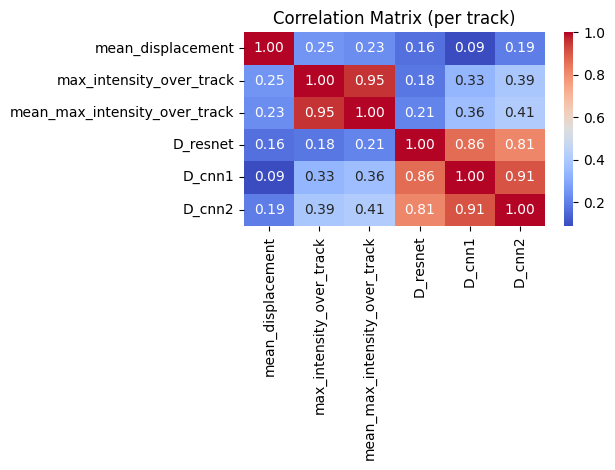

In [18]:

def computeCorrforFeaturesPlotCorr(df, features, index='track_id'):

    # Step 1: Reset index to access 'track_id' as a column
    df_per_frame = df.reset_index()

    # Step 2: Drop duplicates to get one row per track (since these values are constant within each track)
    df_per_track = df_per_frame.drop_duplicates(subset='track_id')[
        features
    ].set_index('track_id')

    # Step 3: Compute Pearson correlation matrix
    correlation_matrix = df_per_track.corr()

    # Step 4: Extract correlations with 'mean_displacement'
    correlation_with_disp = correlation_matrix['mean_max_intensity_over_track'][['D_resnet', 'D_cnn1', 'D_cnn2']]

    print("Correlation between mean_displacement and each model prediction:")
    print(correlation_with_disp)
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
    plt.title("Correlation Matrix (per track)")
    plt.tight_layout()
    plt.show()
    return correlation_matrix

corr_matrix = computeCorrforFeaturesPlotCorr(df_tracks, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])


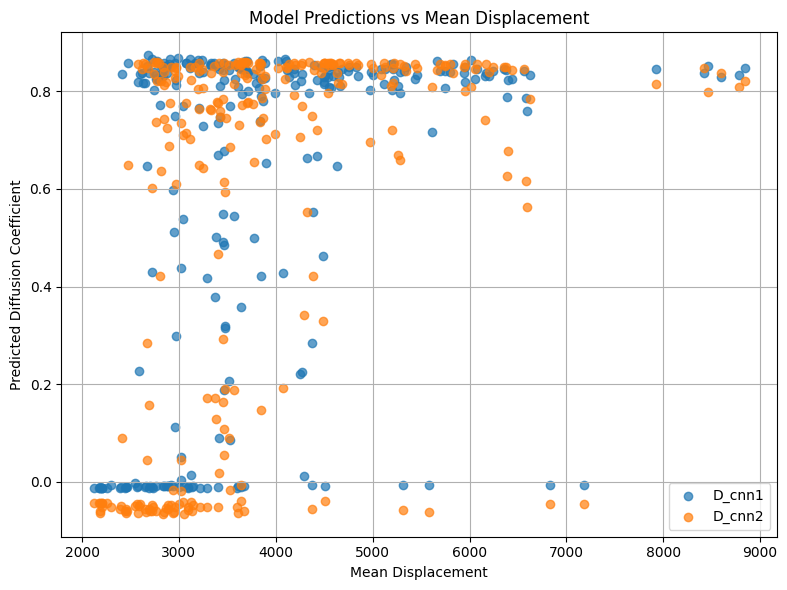

In [19]:
import matplotlib.pyplot as plt

def plotPointsVsFeature(df, features, x_feat, chosen_models):
    # Extract per-track values (as done before)
    track_level_df = df.groupby(level=0).first()[
        features
    ]

    # Plot
    plt.figure(figsize=(8, 6))

    # Loop over each model prediction column
    for column in chosen_models:
        plt.scatter(track_level_df[x_feat], track_level_df[column], label=column, alpha=0.7)

    plt.xlabel('Mean Displacement')
    plt.ylabel('Predicted Diffusion Coefficient')
    plt.title('Model Predictions vs Mean Displacement')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
chosen_models = ['D_resnet', 'D_cnn1', 'D_cnn2']
chosen_models2 = [ 'D_cnn1', 'D_cnn2']

plotPointsVsFeature(df_tracks, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


In [20]:
# Step 1: Get one row per track with D_deppcnn1 values
track_level_df = df_tracks.groupby(level=0).first()

# Step 2: Filter based on D_deppcnn1 threshold
under_3_ids = track_level_df[track_level_df['D_cnn1'] < 0.1].index
over_3_ids = track_level_df[track_level_df['D_cnn1'] >= 0.1].index

# Step 3: Filter original df_tracks using those IDs
df_under_3 = df_tracks.loc[df_tracks.index.get_level_values(0).isin(under_3_ids)]
df_over_3 = df_tracks.loc[df_tracks.index.get_level_values(0).isin(over_3_ids)]

Correlation between mean_displacement and each model prediction:
D_resnet   -0.053390
D_cnn1      0.180229
D_cnn2      0.293442
Name: mean_max_intensity_over_track, dtype: float64


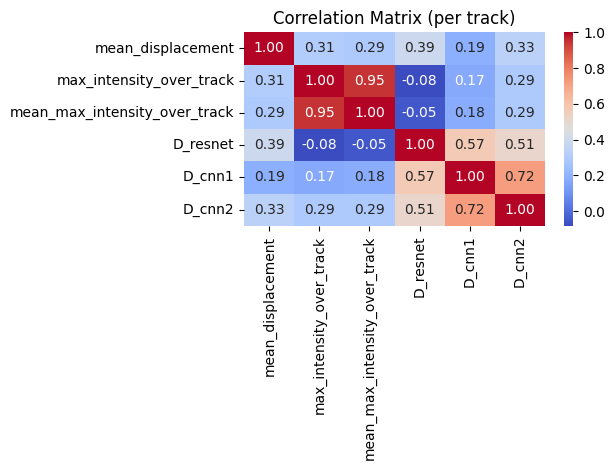

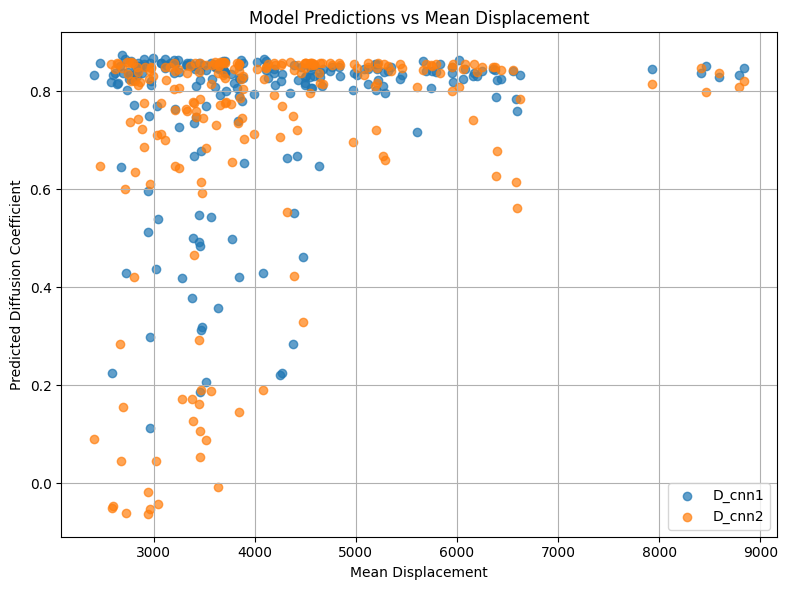

In [21]:
corr_matrix = computeCorrforFeaturesPlotCorr(df_over_3, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plotPointsVsFeature(df_over_3, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


Correlation between mean_displacement and each model prediction:
D_resnet   -0.285606
D_cnn1      0.122918
D_cnn2      0.068577
Name: mean_max_intensity_over_track, dtype: float64


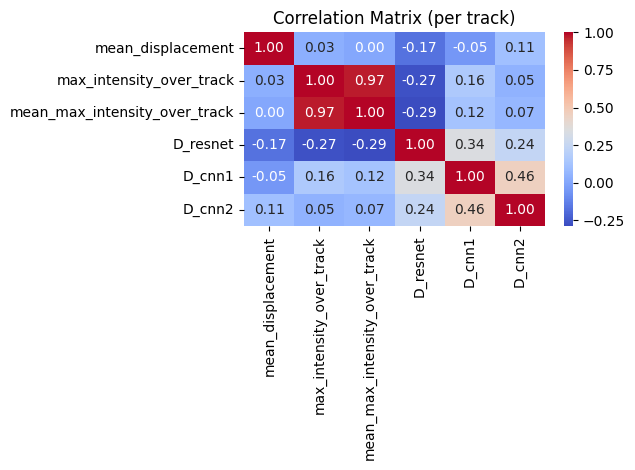

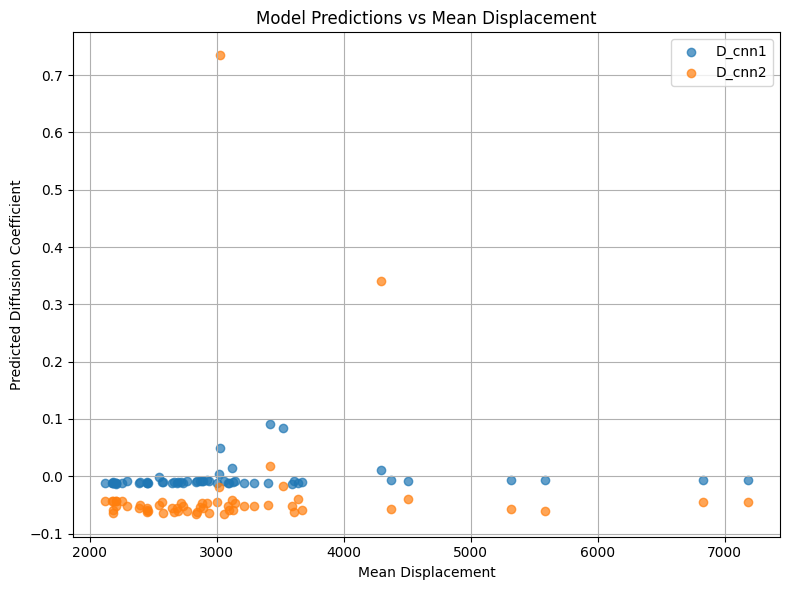

In [22]:
corr_matrix = computeCorrforFeaturesPlotCorr(df_under_3, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plotPointsVsFeature(df_under_3, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


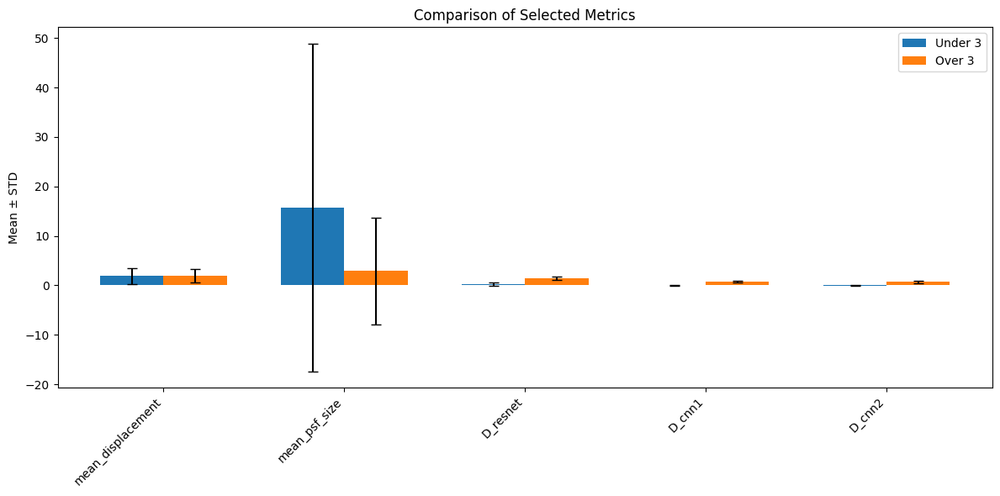

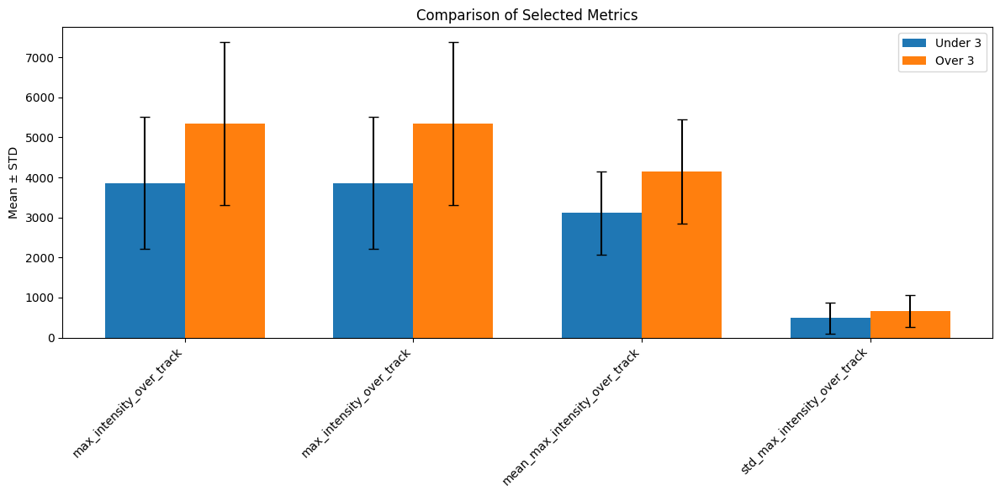

In [23]:
df_under_3_track = df_under_3.groupby(level=0).first()

df_over_3_track = df_over_3.groupby(level=0).first()



plot_comparison_with_std(df_under_3, df_over_3, columns=['mean_displacement','mean_psf_size' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plot_comparison_with_std(df_under_3, df_over_3, columns=['max_intensity_over_track','max_intensity_over_track','mean_max_intensity_over_track','std_max_intensity_over_track'])

